<font color='darkblue' size=18>Mapas COVID con python</font><img src="img/Mercator-projection.jpg" align='right'><img src="img/python-logo.png" align='right'>

### <font color='darkblue' size=12> Provincias de España</font>

#### Vamos a usar python y alguna de sus librerías para crear una representación gráfica de datos sobre un mapa.

##### Para ello necesitamos:

    1. Un mapa base.
    2. Shape de cada área del mapa.
    3. Datos a representar de cada área/shape.
    4. Asociar los datos de provincias a cada shape.
    5. Mapa con los datos.

#### En este caso, serán datos de situación del COVID-19 en España por provincias.
### Necesitamos datos:
- Los shapes de las provincias españolas forman el mapa de España.
- Un dato a representar en el mapa. He escogido la Tasa de Incidencia Acumulada en los últimos 14 días. Esta serie de datos se llamará **TIA_14d**.

### Necesitamos librerías que nos permitan acceder a los datos, procesarlos y presentarlos de manera interactiva:

- Podemos usar datos en local ó acceder a ellos a traves de su url pública. En este caso será con los datos de [@esCOVID19data](https://github.com/montera34/escovid19data) ==> https://github.com/montera34/escovid19data

- Vamos a usar distintas librerías para los gráficos: geoviews, holoviews, geoviews, en los mapas interactivos y matplotlib para crear ficheros png y luego un gif.

- Terminando con opciones interactivas.


<br><br>
### Empecemos preparando el entorno e importando las librerías que vamos a usar

In [1]:
# # Las dos siguientes líneas de código nos permite usar el 100% del ancho de pantalla.
from IPython.display import display, HTML, Markdown
display(HTML("<style>.container { width:100% !important; }</style>"))


from IPython.core.interactiveshell import InteractiveShell  # Para mostrar más de una salida por celda en el notebook.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
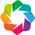

In [2]:
import geopandas as gpd
import geoviews as gv
import cartopy.crs as ccrs
import pandas as pd
import numpy as np
import panel as pn
import hvplot.pandas
from bokeh.models import FixedTicker as bk_FixedTicker, HoverTool as bk_HoverTool
import holoviews as hv
import matplotlib.pyplot as plt
import matplotlib as  mpl
import matplotlib.colors as colors


gv.extension('bokeh')

<br><br>
# 1. Mapa Base.

    En esta ocasión será de Wikipedia. Hay otras opciones posibles de Mapa Base.

In [3]:
Mapa_Base = gv.tile_sources.Wikipedia
Mapa_Base  # Ya tenemos Mapa Base y es interactivo!!

:WMTS   [Longitude,Latitude]

---
---
<br><br>
## 2. Colección de shapes de provincias de España.


### - Cargamos en un GeoDataFrame los shapes. Uso el fichero de shapes de carto por una buena relación entre la calidad de los shapes y su consumo de recursos.

He descartado los shapes oficiales, por tener Los ficheros los proporciona el Centro Nacional de Información Geográfica<img src="img/CARTO-logo.svg" align='right' />
- Proporciona los shapes de los límites administrativos de Provincias. [Datos de shapes](https://centrodedescargas.cnig.es/CentroDescargas)


https://vangdata.carto.com/tables/shapefiles_provincias_espana/public/map


- Podríamos acceder a estos ficheros directamente online ó descargarlo y usarlo como fichero local.
<br><br>
#### **PREVIAMENTE** he descargado el fichero con los shapes de las provincias a un subdirectorio llamado 'Shapes_Provincias'
### Cargando los shapes

In [4]:

gdf_provincias = gpd.read_file('Shapes_Provincias/carto') # Le he indicado el nombre del subdirectorio y geopandas se encarga de cargar lo necesario.

gdf_provincias.drop(['cartodb_id','ccaa','cod_ccaa','texto_alt','texto'], axis=1, inplace=True)
gdf_provincias['codigo']=gdf_provincias['codigo'].astype(int)
gdf_provincias  # NO hay que adaptar las coordenadas de los shapes al estandar Mercator. Ya está correcto
gdf_provincias.head()

,codigo,geometry
0,1,"POLYGON ((-3.02679 43.21665, -3.01900 43.21076..."
1,2,"POLYGON ((-1.48366 39.41824, -1.48845 39.41739..."
2,3,"MULTIPOLYGON (((-0.48546 38.16507, -0.48545 38..."
3,4,"MULTIPOLYGON (((-2.19104 36.72004, -2.19129 36..."
4,5,"POLYGON ((-5.01386 41.16425, -5.01094 41.16197..."


### Tenemos cargados los shapes

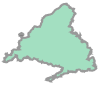

In [5]:
# Por ejemplo, shape de Madrid,
gdf_provincias.loc[26].geometry

In [6]:
Mapa_provincias = gv.Polygons(gdf_provincias)
Mapa_provincias.opts( color='darkgreen')   # Ya tenemos la capa de provincias!!

:Polygons   [Longitude,Latitude]

### 2.1 Juntamos el Base y los Shapes de ZBS

In [7]:
Mapa_Base * Mapa_provincias  # Juntando Piezas.

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]

----
----
<br><br>
## 3. Cargamos datos de COVID para cada provincia

- Usamos los datos de Escovi19data como fuente de datos COVID para todas las provincias desde el principio de la pandemia. Se actualiza a diario, Un gran trabajo, realizado por EsCovid19data. Está disponible en el repositorio <font size=4> https://github.com/montera34/escovid19data </font> Puedes usarlo. Es muy laborioso conseguir datos fiables para este dataset. Contrastando datos de las Comunidades Autónomas y el Instituto de Salud Carlos III.



[Datos COVID-19 por provincia](https://raw.githubusercontent.com/montera34/escovid19data/master/data/output/covid19-provincias-spain_consolidated.csv)

#### Cargamos los datos directamente desde el repositorio para usar siempre los datos más actualizados.
#### El dataset tiene un registro para cada provincia, cada día.
#### - Tiene múltiples columnas ahora vamos a usar:
#####   - 'date': la fecha de cada registro
#####   - 'province': Nombre de la provincia
#####   - 'ine_code': Código del Instituto Nacional de Estadística para identificar la provincia.
#####   - 'ccaa': Comunidad Autónoma a la que pertenece esta provincia.
#####   - 'poblacion': población de esta provincia según el padrón de 2019
#####   - 'ia14': Incicencia Acumulada a 14 días

<br><br>
##### podríamos descargar el fichero csv y acceder al fichero descargado

In [8]:

url_fichero='https://raw.githubusercontent.com/montera34/escovid19data/master/data/output/covid19-provincias-spain_consolidated.csv'

%time df_covid_provincias_base = pd.read_csv(url_fichero, \
                                             sep=',', \
                                             encoding='utf-8', \
                                             decimal='.', \
                                             parse_dates=['date'], \
                                             usecols=['date', 'province', 'ine_code', 'ccaa', 'poblacion', 'ia14'] )


CPU times: user 75.4 ms, sys: 25 ms, total: 100 ms
Wall time: 1.41 s


In [9]:
# Por comodidad en el cálculo posterior. Lo convertimos a Dataframe MultiIndex
dfMI_covid_provincias=df_covid_provincias_base.set_index(keys=['date','ccaa', 'province'], append=False, drop=True).unstack(['ccaa','province']).sort_index(axis=1)

dfMI_covid_provincias.info(memory_usage='deep')
dfMI_covid_provincias.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 397 entries, 2020-01-01 to 2021-01-31
Columns: 156 entries, ('ia14', 'Andalucía', 'Almería') to ('poblacion', 'Rioja, La', 'Rioja, La')
dtypes: float64(156)
memory usage: 486.9 KB


ia14                                                          \
ccaa       Andalucía                                                  Aragón   
province     Almería Cádiz Córdoba Granada Huelva Jaén Málaga Sevilla Huesca   
date                                                                           
2020-01-01       NaN   NaN     NaN     NaN    NaN  NaN    NaN     NaN    NaN   
2020-01-02       NaN   NaN     NaN     NaN    NaN  NaN    NaN     NaN    NaN   
2020-01-03       NaN   NaN     NaN     NaN    NaN  NaN    NaN     NaN    NaN   
2020-01-04       NaN   NaN     NaN     NaN    NaN  NaN    NaN     NaN    NaN   
2020-01-05       NaN   NaN     NaN     NaN    NaN  NaN    NaN     NaN    NaN   

                   ... poblacion                                           \
ccaa               ...   Galicia            Madrid, Comunidad de  Melilla   
province   Teruel  ...   Ourense Pontevedra               Madrid  Melilla   
date               ...                                                      
2020-01-01    NaN  ...  307651.0   942665.0            6663394.0  86487.0   
2020-01-02    NaN  ...  307651.0   942665.0            6663394.0  86487.0   
2020-01-03    NaN  ...  307651.0   942665.0            6663394.0  86487.0   
2020-01-04    NaN  ...  307651.0   942665.0            6663394.0  86487.0   
2020-01-05    NaN  ...  307651.0   942665.0            6663394.0  86487.0   

                                                                      \
ccaa       Murcia, Región de Navarra, Comunidad Foral de  País Vasco   
province              Murcia                     Navarra Araba/Álava   
date                                                                   
2020-01-01         1493898.0                    654214.0    331549.0   
2020-01-02         1493898.0                    654214.0    331549.0   
2020-01-03         1493898.0                    654214.0    331549.0   
2020-01-04         1493898.0                    654214.0    331549.0   
2020-01-05         1493898.0                    654214.0    331549.0   

                                           
ccaa                            Rioja, La  
province      Bizkaia  Gipuzkoa Rioja, La  
date                                       
2020-01-01  1152651.0  723576.0  316798.0  
2020-01-02  1152651.0  723576.0  316798.0  
2020-01-03  1152651.0  723576.0  316798.0  
2020-01-04  1152651.0  723576.0  316798.0  
2020-01-05  1152651.0  723576.0  316798.0  

[5 rows x 156 columns]

<br><br>
### Calculamos la ia14_interpolate es la ia14 interpolada de los días que no ha habido datos de las Comunidades.

### También calculamos la diferencia de la ia14 actual con la de hace 7 días para ir viendo ritmo de crecimiento

### Juntamos todos en el mismo DataFrame dfMI_covid_provincias


In [10]:
dfMI_covid_provincias.poblacion = dfMI_covid_provincias.poblacion.interpolate(method='linear', axis=0) # Para rellenar huecos
dfMI_covid_provincias.ine_code=dfMI_covid_provincias.ine_code.interpolate(method='linear', axis=0) # Para rellenar huecos

# Series nuevas
dfMI_ia14_interpolate = dfMI_covid_provincias.loc[:,('ia14',slice(None))].interpolate(method='linear', axis=0).rename(columns={'ia14':'ia14_interpolate'})
dfMI_ia14_diff7d = dfMI_ia14_interpolate.loc[:,('ia14_interpolate',slice(None))].diff(7).rename(columns={'ia14_interpolate':'ia14_diff7d'})
dfMI_covid_provincias = pd.concat([dfMI_covid_provincias, dfMI_ia14_interpolate, dfMI_ia14_diff7d], axis=1)

In [11]:
# Retornamos el DataFrame MultiIndex a Dataframe 2D
df_covid_provincias = dfMI_covid_provincias.stack([1,2]).reset_index()
df_covid_provincias.tail() #Ya tenemos un DataFrame con un registro por día y provincia con la ia14 interpolada y su diferencia a 7d calculada.

,date,ccaa,province,ia14,ia14_diff7d,ia14_interpolate,ine_code,poblacion
20639,2021-01-31,"Navarra, Comunidad Foral de",Navarra,NaN,20.60,469.4,31.0,654214.0
20640,2021-01-31,País Vasco,Araba/Álava,NaN,98.00,633.7,1.0,331549.0
20641,2021-01-31,País Vasco,Bizkaia,NaN,101.30,701.9,48.0,1152651.0
20642,2021-01-31,País Vasco,Gipuzkoa,NaN,80.30,553.8,20.0,723576.0
20643,2021-01-31,"Rioja, La","Rioja, La",NaN,115.55,1354.2,26.0,316798.0


<br><br>
### 3.1 Filtramos el último dato de cada provincia

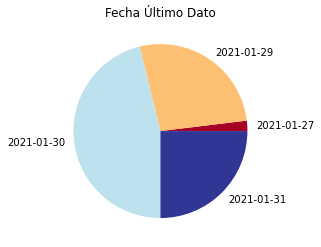

In [12]:
# Ahora sacamos un DataFrame con el último dato de ia14 para cada provincia. Cada provincia puede ser de fecha distinta.

df_covid_provincias_ultimodato = df_covid_provincias.loc[df_covid_provincias.loc[~df_covid_provincias.ia14.isna()].groupby( 'ine_code' )['date'].idxmax()] 

df_covid_provincias_ultimodato.date.dt.strftime("%F").value_counts().sort_index().plot(kind='pie', title='Fecha Último Dato', ylabel='', cmap="RdYlBu");

In [13]:
# Tenemos los 52 últimos datos de cada provincia
df_covid_provincias_ultimodato.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52 entries, 20588 to 20585
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   date              52 non-null     datetime64[ns]
 1   ccaa              52 non-null     object        
 2   province          52 non-null     object        
 3   ia14              52 non-null     float64       
 4   ia14_diff7d       52 non-null     float64       
 5   ia14_interpolate  52 non-null     float64       
 6   ine_code          52 non-null     float64       
 7   poblacion         52 non-null     float64       
dtypes: datetime64[ns](1), float64(5), object(2)
memory usage: 11.1 KB


----
----

<br><br>

## 4. <font color='darkblue'>Hacemos un merge entre el GeoDataFrame y el último dato de cada provincia

In [14]:

gdf_covid_provincias = gdf_provincias.xs(['codigo','geometry'], axis=1).merge(df_covid_provincias_ultimodato, left_on='codigo', right_on='ine_code', how='left')

In [15]:
# Quitamos la columna repetida

gdf_covid_provincias.drop(columns=['ine_code'], inplace=True)
gdf_covid_provincias.info(memory_usage='deep')

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 52 entries, 0 to 51
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   codigo            52 non-null     int64         
 1   geometry          52 non-null     geometry      
 2   date              52 non-null     datetime64[ns]
 3   ccaa              52 non-null     object        
 4   province          52 non-null     object        
 5   ia14              52 non-null     float64       
 6   ia14_diff7d       52 non-null     float64       
 7   ia14_interpolate  52 non-null     float64       
 8   poblacion         52 non-null     float64       
dtypes: datetime64[ns](1), float64(4), geometry(1), int64(1), object(2)
memory usage: 11.5 KB


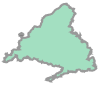

In [16]:
gdf_covid_provincias.geometry[26]

<br><br>
Vemos un DataFrame con 52 registros.

Uno por cada provincia

Con 8 campos en cada registro.
- Codigo:     Identifica a cada provincia.
- geometry:   El polygono de cada provincia.
- date:  fecha de los datos.
- ccaa:  Comunidad Autónoma de la provincia.
- province: Nombre de la provincia.
- ia14:         Tasa de Incidencia Acumulada en los últimos 14 días.
- ia14_interpolate:  ia14 interpolada por los huecos existentes.
- ia14_diff7d: diferencia de la última ia14 sobre la existente 7 días antes. Podría ser interpolada.
- población: Población de la provincia según INE.

In [17]:
# Creamos los mapas de península y Canarias por separado.

Mapa_peninsula_COVID = gv.Polygons(gdf_covid_provincias.loc[gdf_covid_provincias.ccaa!='Canarias'],
                                   vdims=['ia14_interpolate', 'ccaa', 'province', 'date', 'ia14', 'ia14_interpolate']).\
                                   opts( line_color='grey', cmap='magma_r')

Mapa_Canarias_COVID = gv.Polygons(gdf_covid_provincias.loc[(gdf_covid_provincias.ccaa=='Canarias')],
                                  vdims=['ia14_interpolate','ccaa', 'province', ('date', 'Fecha del Dato')]).opts(\
                                        line_color='grey', cmap='magma_r')

# Creamos un pop-up a medida

hover_Provincias = bk_HoverTool(tooltips= [  (  "",'@{ccaa}'),  ("Provincia  ", '@{province}'),
                                           ("TIA-14 ", '@{ia14_interpolate}{0}'), ("Dia " , " @{date}{%F}") ],
                         formatters={'@{date}': 'datetime'} )

Mapa_peninsula_COVID.opts(width=550, height=400,
                          ylim=(35,44) , xlim=(-9.5,4.5),
                          colorbar=True,
                          title='+oscuro +incidencia, rango de valores/colores automático',
                          tools=[hover_Provincias]) #Ya es interactivo



:Polygons   [Longitude,Latitude]   (ia14_interpolate,ccaa,province,date,ia14,ia14_interpolate)

In [18]:
# Aquí grabamos el fichero con colores y rangos automáticos

gv.renderer('bokeh').save( Mapa_peninsula_COVID, 'Mapa_peninsula_COVID_auto') 

---
<font color='darkblue' size=18 >Adaptamos el Mapa con Niveles y Colormap adaptado</font>

In [19]:
# Definimos un entorno colormap a medida para la ocasión.
colormap_COVID = ['#006837' , '#86cb66', '#ffffbf', '#f98e52', '#FF0000','#a50026']

Niveles_COVID = [0, 25, 50, 150, 250, 500, 530]

Colorbar_ticks = bk_FixedTicker(ticks=[  12.5, 25, 37.5, 50, 100, 150, 200, 250, 325, 500, 530])

Colorbar_labels =  {
            37.5: 'Riesgo Bajo',
            12.5: 'Nueva Normalidad',
            25:   '25',
            50:   '50',
            100: 'Riesgo Medio',
            150:  '150',
            200: 'Riesgo Alto',
            250:  '250',
            325: 'Riesgo Extremo',
            500:  '500',
            530: 'Confinamiento Recomendado ECDC'
        }




In [20]:
fecha = Mapa_peninsula_COVID.dimension_values(dim='date')[0].strftime("%F")

Mapa_peninsula_COVID_semaforo=Mapa_peninsula_COVID.opts(width=750, height=500, ylim=(35,44) , xlim=(-9.5,4.5),
                          colorbar=True, clim=(0, 530),
                          title=f"+oscuro +incidencia, rango de valores/colores Semáforo COVID "+'\n'+fecha,
                          color_levels=Niveles_COVID,
                          cmap=colormap_COVID,
                          colorbar_opts={
                            'major_label_overrides': Colorbar_labels,
                            'major_label_text_align': 'left', 'ticker': Colorbar_ticks
                            })  

Mapa_peninsula_COVID_semaforo



:Polygons   [Longitude,Latitude]   (ia14_interpolate,ccaa,province,date,ia14,ia14_interpolate)

In [21]:
Mapa_peninsula_COVID.dimension_values(dim='date')[0].strftime("%F")

'2021-01-30'

In [22]:
Mapa_Canarias_COVID_semaforo =Mapa_Canarias_COVID.opts(width=250, height=150, xaxis=None, yaxis=None,
                         color_levels=Niveles_COVID, tools=[hover_Provincias],
                         cmap=colormap_COVID,
                         colorbar_opts={
                            'major_label_overrides': Colorbar_labels,
                            'major_label_text_align': 'left', 'ticker': Colorbar_ticks
                            })  

Mapa_Canarias_COVID_semaforo

:Polygons   [Longitude,Latitude]   (ia14_interpolate,ccaa,province,date)

---
---
### 5. Mapa interactivo con los datos.

 - Juntamos Mapa Base y la capa con los datos de las provincias.
 - Tocamos algo las opciones para adaptar la visibilidad.

# Mapa con Shapes de provincias y con gradiente de color según TIA_14d

In [23]:
# Mapa de la Peninsula y canarias con colormap magma_r  +oscuro +Incidencia
(Mapa_peninsula_COVID_semaforo +
Mapa_Canarias_COVID_semaforo).cols(1).opts(shared_axes=False)

:Layout
   .Polygons.I  :Polygons   [Longitude,Latitude]   (ia14_interpolate,ccaa,province,date,ia14,ia14_interpolate)
   .Polygons.II :Polygons   [Longitude,Latitude]   (ia14_interpolate,ccaa,province,date)

----
<br><br>
## Y cuando lo exportamos en formato html. Sigue interactivo!!

In [24]:
gv.renderer('bokeh').save( Mapa_peninsula_COVID_semaforo, 'Mapa_peninsula_COVID_semaforo')  # aquí hemos creado el fichero Mapa_peninsula_COVID_semaforo.html

<br><br>

## <font color='darkred'>Lo hacemos más interactivo con opción de Vistas por Condición?

    - Por ejemplo: Filtrar las provincias con TIA_14d mayor que un valor indicado. Es fácil.
    
    AVISO: Tarda un poquito en realizar el filtrado.

In [25]:
# Creamos una función para reutilizarla

def Actualizar_polys_hv(umbral):
    
    return hv.Polygons(gdf_covid_provincias[gdf_covid_provincias['ia14_interpolate'] > umbral], vdims=['ia14_interpolate', 'ccaa', 'province', 'date']).opts(clim=(0, 630), width=950, height=700, tools=[hover_Provincias], alpha=0.65,
                    color_levels=Niveles_COVID, line_color='grey', xlim=(-10,5), ylim=(35,45), xaxis=None, yaxis=None,
                    cmap= colormap_COVID, colorbar=True, colorbar_opts={
                    'major_label_overrides': Colorbar_labels,
                    'major_label_text_align': 'left', 'ticker': Colorbar_ticks
                    })



wdg_IntSlider = pn.widgets.IntSlider(name='TIA_14d Mayor que ', start=0, end=int(gdf_covid_provincias['ia14_interpolate'].max()-1), value=400)


pn.Row(
            pn.Column(Markdown(f"<font color='darkblue' size=5' >Mapa muestra solo provincias con IA_14d superior al umbral indicado<br><br>"),wdg_IntSlider),
            #gv.tile_sources.Wikipedia(alpha=1) * 
            hv.DynamicMap(pn.bind(Actualizar_polys_hv, wdg_IntSlider))
        )



Row
    [0] Column
        [0] Markdown(Markdown)
        [1] IntSlider(end=2456, name='TIA_14d Mayor que ', value=400, value_throttled=400)
    [1] HoloViews(DynamicMap)

In [26]:
pn.Column( Markdown(f"## <br><br> Puedes filtrar el valor de TIA-14d."),
           Markdown(f"### Presentará las ZBS con TIA_14d Mayor de la seleccionada."),
           pn.Row(
                wdg_IntSlider,
                hv.DynamicMap(pn.bind(Actualizar_polys_hv, wdg_IntSlider))
            )
        )

Column
    [0] Markdown(Markdown)
    [1] Markdown(Markdown)
    [2] Row
        [0] IntSlider(end=2456, name='TIA_14d Mayor que ', value=400, value_throttled=400)
        [1] HoloViews(DynamicMap)

---

<br>
<br>

<font color='navy' size=14 > Ahora con todos los datos históricos de todas las provincias.</font>

In [27]:
gdf_covid_provincias_historico = gdf_provincias.xs(['codigo','geometry'], axis=1).merge(df_covid_provincias, left_on='codigo', right_on='ine_code', how='left')

gdf_covid_provincias_historico.info(memory_usage='deep')

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 20644 entries, 0 to 20643
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   codigo            20644 non-null  int64         
 1   geometry          20644 non-null  geometry      
 2   date              20644 non-null  datetime64[ns]
 3   ccaa              20644 non-null  object        
 4   province          20644 non-null  object        
 5   ia14              13976 non-null  float64       
 6   ia14_diff7d       14746 non-null  float64       
 7   ia14_interpolate  15110 non-null  float64       
 8   ine_code          20644 non-null  float64       
 9   poblacion         20644 non-null  float64       
dtypes: datetime64[ns](1), float64(5), geometry(1), int64(1), object(2)
memory usage: 4.6 MB


<br><br>
## Permitimos interactuar tanto por umbral de TIA_14d como la evolución en el tiempo de todas las provincias.


In [28]:
import holoviews as hv

def Actualizar_polys_fecha(umbral, fecha):
    
    return hv.Polygons(gdf_covid_provincias_historico.loc[(gdf_covid_provincias_historico['ia14_interpolate'] > umbral) & (gdf_covid_provincias_historico.date.dt.strftime("%F")==fecha)],
                       vdims=['ia14_interpolate', 'ia14', 'ccaa', 'province', 'ia14_diff7d', 'date']).opts(
                            clim=(0, 530), width=900, height=950, tools=[hover_Provincias], alpha=0.65, xaxis=None, yaxis=None,
                            color_levels=Niveles_COVID, line_color='grey',
                            cmap= colormap_COVID, colorbar=True, colorbar_opts={
                                'major_label_overrides': Colorbar_labels,
                                'major_label_text_align': 'left', 'ticker': Colorbar_ticks}
                            , bgcolor='lightgray')



fechas = sorted(gdf_covid_provincias_historico.date.dt.strftime("%F").unique())

wdg_IntSlider = pn.widgets.IntSlider(name='IA_14d Mayor que ', start=0, end=int(gdf_covid_provincias_historico['ia14_interpolate'].max()-1))
wdg_Slider = pn.widgets.DiscreteSlider(name='Dia ', options=fechas, value=fechas[-1])

pn.Row( pn.Column(
            Markdown(f"## <br><br> Puedes filtrar el valor de IA-14d."),
            Markdown(f"### Presentará las provincias con ia14d Mayor de la seleccionada."),
            Markdown(f"<br>## Se puede seleccionar otras fechas para ver el pasado y la evolución"),
    wdg_IntSlider, wdg_Slider),
    gv.DynamicMap(pn.bind(Actualizar_polys_fecha, wdg_IntSlider, wdg_Slider))
)



Row
    [0] Column
        [0] Markdown(Markdown)
        [1] Markdown(Markdown)
        [2] Markdown(Markdown)
        [3] IntSlider(end=2456, name='IA_14d Mayor que ', value_throttled=0)
        [4] DiscreteSlider(name='Dia ', options=['2020-01-01', ...], value='2021-01-31', value_throttled='2021-01-31')
    [1] HoloViews(DynamicMap)

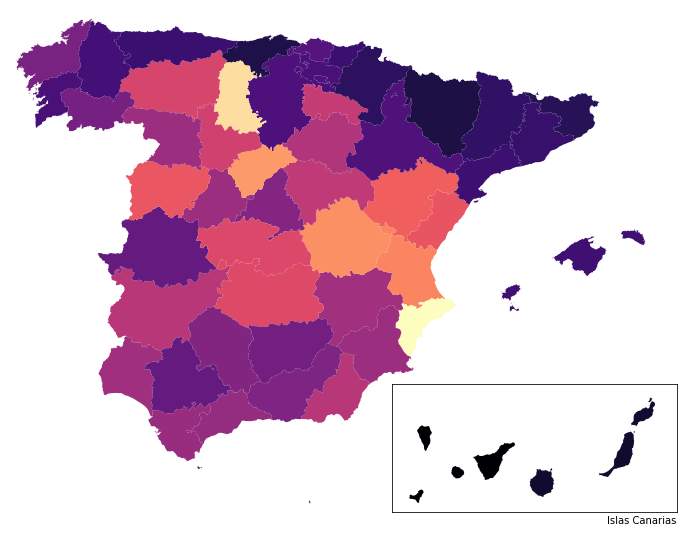

In [29]:
fig, peninsula_ax = plt.subplots(figsize=(12,10))

peninsula_ax  =gdf_covid_provincias.plot(column='ia14_interpolate', ax=peninsula_ax, cmap='magma' )
peninsula_ax.set_xlim(-9.5, 5)
peninsula_ax.set_ylim(35,44);
peninsula_ax.axes.axis('off')

canarias_ax = fig.add_axes([.57, .13, .33, .23])

canarias_ax  =gdf_covid_provincias.plot(column='ia14_interpolate', ax=canarias_ax, cmap='magma')
canarias_ax.set_xlim(-18.5, -13)
canarias_ax.set_ylim(27.5,29.5)
canarias_ax.axes.axis('on');
canarias_ax.axes.set_xticks([])
canarias_ax.set_xlabel('Islas Canarias', loc='right')
#canarias_ax.
canarias_ax.axes.set_yticks([])

plt.show();

In [30]:
Colorbar_ticks = bk_FixedTicker(ticks=[  12.5, 25, 37.5, 50, 100, 150, 200, 250, 325, 500, 530])

mpl_ticks=[  12.5, 25, 37.5, 50, 100, 150, 200, 250, 325, 500, 530]
Colorbar_labels =  {
            37.5: 'Riesgo Bajo',
            12.5: 'Nueva Normalidad',
            25:   '25',
            50:   '50',
            100: 'Riesgo Medio',
            150:  '150',
            200: 'Riesgo Alto',
            250:  '250',
            325: 'Riesgo Extremo',
            500: '500 - Confinamiento Recomendado ECDC',
            530: ''
        }

### Creamos una función con Matplotlib
### - creará el mapa para cada fecha
### - Lo graba en fichero png
### Después los juntaremos en un fichero gif

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

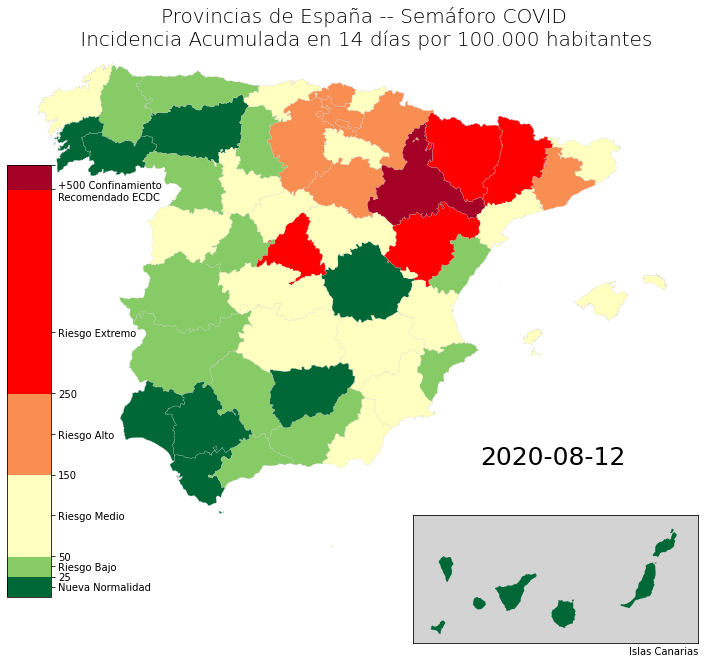

In [31]:
# Rango de valores
vmin, vmax = 0, 530
hv.extension( 'matplotlib');

## Función Mapa_ZBS_para fecha.
def mpl_provincia_fecha(gdf, vmin, vmax, fecha, titulo):
    
    png_fecha=f"img/{gdf.date.iloc[0].strftime('%F')}.png"
    
    # colormap a medida
    cmap = colors.ListedColormap(colormap_COVID, N=6)
    norm = colors.BoundaryNorm(Niveles_COVID, len(Niveles_COVID))

    fig, ax = plt.subplots( figsize=(12, 10) )

    peninsula_ax  =gdf.plot(column='ia14_interpolate', ax=ax, cmap=cmap,
                         linewidth=0.2, edgecolor='0.8', 
                        vmin=vmin, vmax=vmax, norm=norm )
    
    peninsula_ax.set_xlim(-9.5, 5)
    peninsula_ax.set_ylim(35,44);
    peninsula_ax.axes.axis('off')

    peninsula_ax.set_title(titulo, fontdict={'fontsize': 20, 'fontweight' : 3})
    
    peninsula_ax.annotate(gdf.date.iloc[0].strftime("%F"),
                xy=(0,0),xytext=(480,200), xycoords='figure points', fontsize= 25 )
    
    canarias_ax = fig.add_axes([0.57, 0.01, .33, .23])

    canarias_ax  =gdf.plot(column='ia14_interpolate', ax=canarias_ax, cmap=cmap)
    canarias_ax.set_xlim(-18.5, -13)
    canarias_ax.set_ylim(27.5,29.5)
    canarias_ax.axes.axis('on');
    canarias_ax.axes.set_xticks([])
    canarias_ax.set_xlabel('Islas Canarias', loc='right')
    #canarias_ax.
    canarias_ax.axes.set_yticks([])
    canarias_ax.set_facecolor('lightgray')


    cax = fig.add_axes([0.1, 0.1, 0.051, 0.6])  # Para ubicar colorbar

    cbar =plt.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        boundaries= Niveles_COVID,
        extend='neither',
        spacing='proportional',
        orientation='vertical',
        ticks=mpl_ticks,
    )

    
    cbar.set_ticklabels(['Nueva Normalidad', 25, 'Riesgo Bajo', 50, 'Riesgo Medio', 150, 'Riesgo Alto', 250, 'Riesgo Extremo', '+500 Confinamiento\nRecomendado ECDC'] )

    bbox_inches='tight'
    
    return fig




# Ahora probamos la creación de un Mapa para una fecha con los datos para una fecha concreta

fig_Mapa_provincias_fecha =    mpl_provincia_fecha(gdf_covid_provincias_historico.loc[(gdf_covid_provincias_historico.date.dt.strftime("%F")=="2020-08-12")],
                                   vmin, vmax, 
                                   '2020-08-12',
                                   'Provincias de España -- Semáforo COVID\n Incidencia Acumulada en 14 días por 100.000 habitantes')
plt.show()
plt.close(fig_Mapa_provincias_fecha)

# La salida del mapa puede parecer desajustada.
# Sin embargo, al crear el gif lo deja 'colocado'


In [32]:
# Ahora usamos la funcion para crear un Mapa para cada fecha

lista_files=[]
hv.extension( 'matplotlib');

for fecha in gdf_covid_provincias_historico.loc[(gdf_covid_provincias_historico.date> '2020-03-08'),'date'].dt.date.unique():  # Para cada fecha
    
    gdf_provincias_fecha = gdf_covid_provincias_historico.loc[(gdf_covid_provincias_historico.date.dt.strftime("%F")==fecha.strftime("%F"))]
    
    png_fecha=f"img/{gdf_provincias_fecha.date.iloc[0].strftime('%F')}.png"

    print(f"Creando para {fecha} ... fichero {png_fecha}")
    
    fig_Mapa_provincias_fecha = mpl_provincia_fecha( gdf_provincias_fecha, vmin, vmax, fecha,
                                  'Provincias de España -- Semáforo COVID\n Incidencia Acumulada en 14 días por 100.000 habitantes')
    
    fig_Mapa_provincias_fecha.savefig(png_fecha, dpi=90, facecolor='lightgray', pad_inches=0.1  )
    
    plt.close(fig_Mapa_provincias_fecha)

    lista_files.append(png_fecha)  # Añadido a la lista de ficheros.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

Creando para 2020-03-09 ... fichero img/2020-03-09.png
Creando para 2020-03-10 ... fichero img/2020-03-10.png
Creando para 2020-03-11 ... fichero img/2020-03-11.png
Creando para 2020-03-12 ... fichero img/2020-03-12.png
Creando para 2020-03-13 ... fichero img/2020-03-13.png
Creando para 2020-03-14 ... fichero img/2020-03-14.png
Creando para 2020-03-15 ... fichero img/2020-03-15.png
Creando para 2020-03-16 ... fichero img/2020-03-16.png
Creando para 2020-03-17 ... fichero img/2020-03-17.png
Creando para 2020-03-18 ... fichero img/2020-03-18.png
Creando para 2020-03-19 ... fichero img/2020-03-19.png
Creando para 2020-03-20 ... fichero img/2020-03-20.png
Creando para 2020-03-21 ... fichero img/2020-03-21.png
Creando para 2020-03-22 ... fichero img/2020-03-22.png
Creando para 2020-03-23 ... fichero img/2020-03-23.png
Creando para 2020-03-24 ... fichero img/2020-03-24.png
Creando para 2020-03-25 ... fichero img/2020-03-25.png
Creando para 2020-03-26 ... fichero img/2020-03-26.png
Creando pa

---
<br>
<br>

### Ahora hacemos la conversión a gif de los png generados

In [58]:
import os
import imageio


images = []
#for file_name in sorted(lista_files[:-10:2]+lista_files[-10:]):        
for file_name in sorted(lista_files):        
        images.append(imageio.imread(file_name))
        
imageio.mimsave('img/provincias_ia14d.gif', images, fps=1 )

In [55]:
imageio.mimsave('img/provincias_ia14d_fps2_5.gif', images, fps=2 )